# To Visualize
- RMSE (+ MAB Losses)
- (Weight MAB behaviour)
- Majority Size
- Calls Graph
- Pareto Front + exec_time + #exact calls

# Imports

In [196]:
import plotly
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import pandas as pd
from pathlib import Path
import numpy as np


# Function Definitions

In [2]:
def clean_columns(df: pd.DataFrame):
    out = df.drop([" Error", " Exact_Estimated_Calls"], axis=1, errors="ignore")
    out = out.rename(columns={" Majority_Model_Parameters": "Majority_Size",
                                 " Majority_Size": "Point",
                                 " Point": "Exec_Time",
                                 " Exec_Time": "Error",
                                 " Mean Weight": "Mean Weight",
                                 " Estimation": "Estimation"},)
    return out.reset_index()

In [232]:
def visualize(to_visualize, to_visualize2=None, to_visualize3=None):
  fig = go.Figure(go.Scatter(mode="lines", x=list(range(0, len(to_visualize))), y=to_visualize, marker={"size": 10}, name="Exact Call Execution Time"))
  fig.update_layout(xaxis={"title": "Optimization Steps (exact calls only)"},
                    yaxis={"title": "Exact Call Execution Times (seconds)", "tickformat":",d"},
                    title="Exact Calls Execution Times",
                    width=1920,
                    height=1080,
                    font=dict(size=18, family="Serif", color="Black"),
                    template="plotly_white")
  if to_visualize2 is not None:
      fig.add_trace(go.Scatter(mode="lines", x=list(range(0, len(to_visualize))), y=to_visualize2, marker={"size": 10}, name="Running Average with Window=120"))
  if to_visualize3 is not None:
      fig.add_trace(go.Scatter(mode="lines", x=list(range(0, len(to_visualize))), y=to_visualize3, marker={"size": 10}, name="No Approximation Behaviour"))

  fig.show()


In [40]:
def cumul_calls(decision, target):
    out = [0]*len(decision)
    cumsum = 0
    for idx, elem in enumerate(decision):
        if elem == target:
            cumsum +=1
        out[idx] = cumsum
    return out

In [91]:
def get_costs(df):
    return [i[-1] for i in list(df.index)]
    

In [204]:
def lollipop(df, metrics):
    fig = make_subplots(
    rows=2, cols=2, specs=[[{"type": "scatter"}] * 2] * 2, subplot_titles=tuple(metrics))
    solutions = []
    for i, ch in zip(df.iloc[:, 0], range(65, 65 + len(df))):
        solutions.append("Solution " + str(chr(ch)) + "\t")


    colors = ["#6873f9", "#EE5940", "#00cc96", "#ac65f9"]
    for col, pos, metric, color in zip(
        df.columns, [(1, 1), (1, 2), (2, 1), (2, 2)], metrics, colors
    ):
        print(pos)
        fig.add_trace(
            go.Scatter(
                x=df[col], y=solutions, mode="markers", marker=dict(color=color, size=15),
            ),
            pos[0],
            pos[1],
        )
        fig.add_trace(
            go.Bar(x=df[col], y=solutions, orientation="h", width=0.2, marker_color=color,),
            pos[0],
            pos[1],
        )

    for i in fig["layout"]["annotations"]:
        i["font"] = dict(size=24)
        i["borderwidth"] = 20


    gridwidth = 2.5
    fig.update_xaxes(
        range=[0, 1.8], gridwidth=gridwidth, row=2, col=1,
    )
    fig.update_xaxes(range=[0, 250], gridwidth=gridwidth, row=2, col=2)
    fig.update_xaxes(gridwidth=gridwidth, row=1, col=2)
    fig.update_xaxes(gridwidth=gridwidth, row=1, col=1)

    fig.update_layout(
        width=1920,
        height=1080,
        font=dict(family="Palatino", size=15),
        showlegend=False,
        font_family="Palatino",
        title_font_family="Palatino",
        template="plotly_white",
    )

    fig.show()

metrics = [
    "LUT Occupation (%)",
    "Register Occupation (%)",
    "BRAM Occupation (%)",
    "Max Frequency (MHz)",
] # metrics in the same order

# Read

In [172]:
metrics = [
    "LUT Occupation (%)",
    "Register Occupation (%)",
    "BRAM Occupation (%)",
    "Max Frequency (MHz)",
] # metrics in the same order

In [217]:
controller_exact = pd.read_csv("movado_tests/movado_debug/controller_exact.csv")
controller_mab_voting100 = clean_columns(pd.read_csv("movado_tests/movado_debug/controller_mab_voting2.csv"))
controller_mab_voting80 = clean_columns(pd.read_csv("movado_tests/movado_debug/controller_mab_voting80.csv"))
mab_weight_mab_voting100 = pd.read_csv("movado_tests/movado_debug/mab_weight_mab_voting2.csv")
mab_weight_mab_voting80 = pd.read_csv("movado_tests/movado_debug/mab_weight_mab_voting80.csv")
mab_mab_voting100 = pd.read_csv("movado_tests/movado_debug/mab_mab_voting2.csv")
mab_mab_voting80 = pd.read_csv("movado_tests/movado_debug/mab_mab_voting80.csv")
objective_space_exact = pd.read_csv("movado_tests/movado_debug/objective_space_exact.csv", header=None)
objective_space_voting100 = pd.read_csv("movado_tests/movado_debug/objective_space_mab_voting2.csv", header=None)
objective_space_voting80 = pd.read_csv("movado_tests/movado_debug/objective_space_mab_voting80.csv", header=None)

In [218]:
objective_space_exact.columns = metrics
objective_space_exact.iloc[:, -1] = np.abs(objective_space_exact.iloc[:, -1])
objective_space_voting100.columns = metrics
objective_space_voting100.iloc[:, -1] = np.abs(objective_space_voting100.iloc[:, -1])
objective_space_voting80.columns = metrics
objective_space_voting80.iloc[:, -1] = np.abs(objective_space_voting80.iloc[:, -1])
objective_space_voting80

,LUT Occupation (%),Register Occupation (%),BRAM Occupation (%),Max Frequency (MHz)
0,1.24,0.38,1.48,198.019802
1,1.12,0.36,1.48,185.597624
2,1.18,0.36,1.48,197.160883
3,1.52,0.43,1.48,199.640647
4,1.10,0.35,1.48,182.781941
5,1.17,0.36,1.48,196.927924
6,1.20,0.58,1.48,197.550375
7,1.29,0.55,1.48,201.409869
8,1.27,0.59,1.48,200.000000
9,1.27,0.60,1.48,202.347228


# Visualization

## RMSE

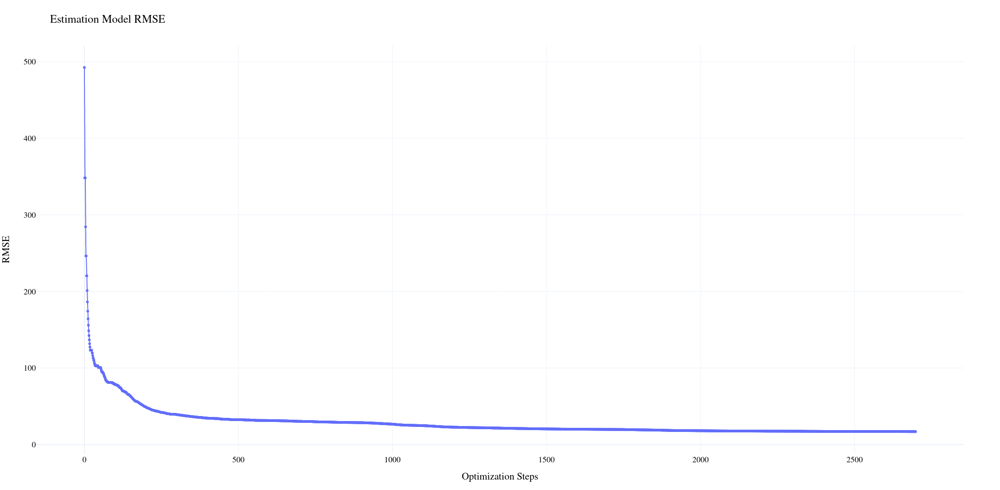

In [24]:
error = controller_mab_voting80.reset_index()["Error"][1:]
visualize(error)

## Controller Decision

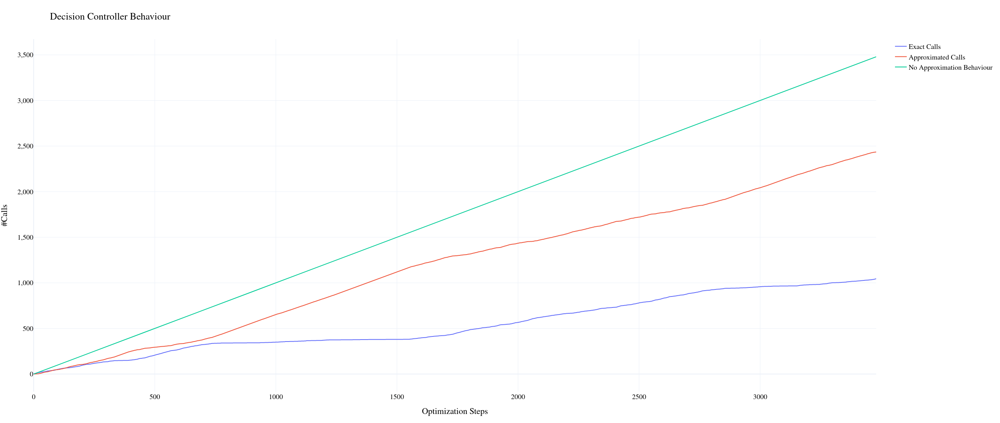

In [52]:
decision = controller_mab_voting100.reset_index()["Estimation"]
exact_decision = cumul_calls([d if d==0 else -1 for d in decision], 0)
estimated_decision = cumul_calls([d if d==1 else -1 for d in decision], 1)
visualize(exact_decision, estimated_decision, list(range(0, len(exact_decision))))

## Mean Weights

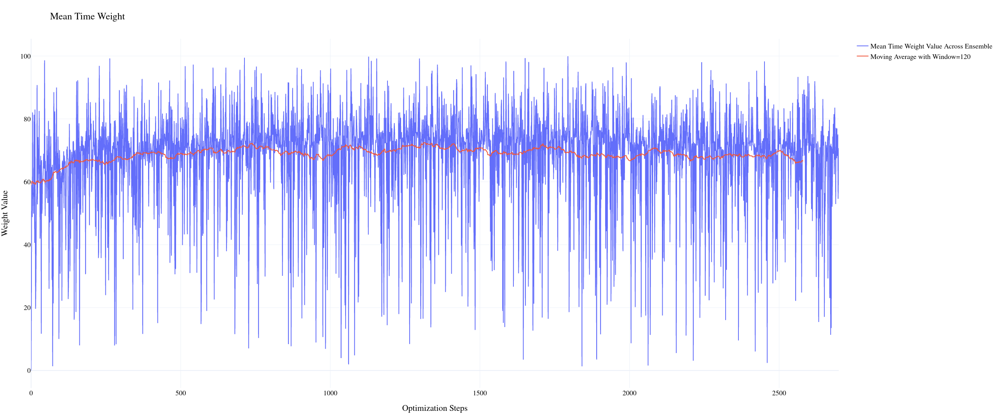

In [80]:
#visualize(controller_mab_voting100["Mean Weight"], [np.mean(controller_mab_voting100["Mean Weight"])]*len(controller_mab_voting100))
visualize(controller_mab_voting80["Mean Weight"], np.convolve(controller_mab_voting80["Mean Weight"].to_numpy(), np.ones(120), "valid")/120)

## Mean Weight Controller Costs

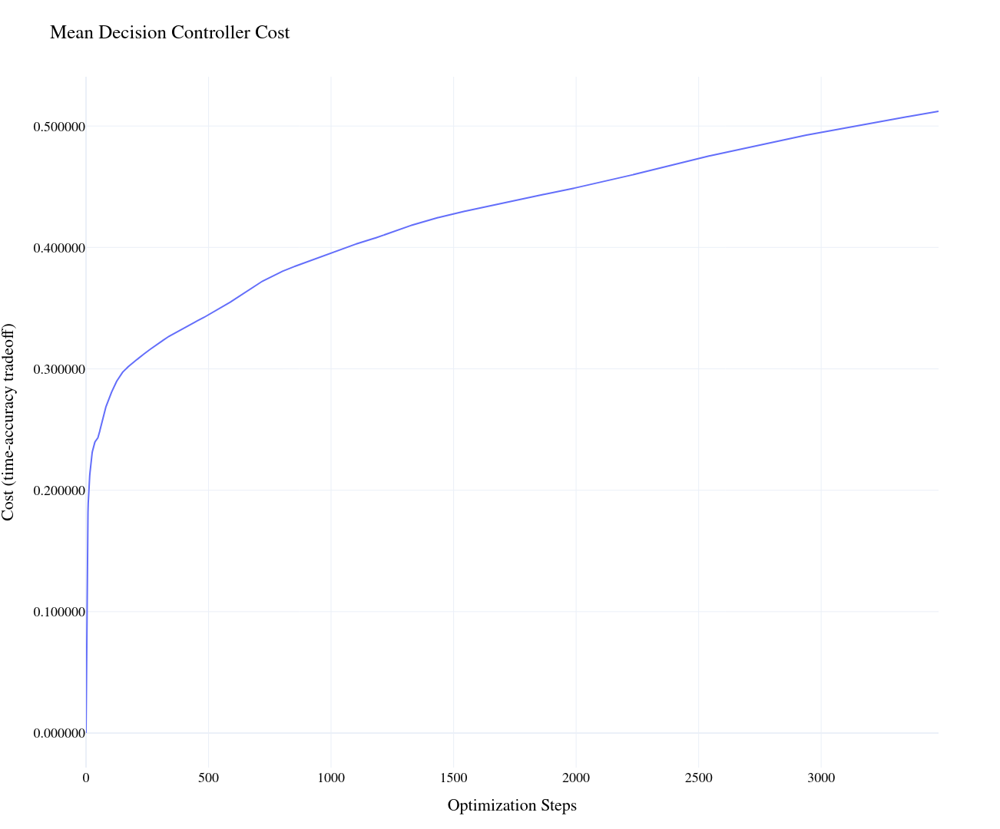

In [138]:
costs = get_costs(mab_weight_mab_voting100)
i=0
temp = []
costs_grouped_weight = []
for cost in costs:
    temp.append(cost)
    i += 1
    if i == 100:
        costs_grouped_weight.append(np.mean(temp))
        temp=[]
        i = 0
visualize(costs_grouped_weight)

    
    

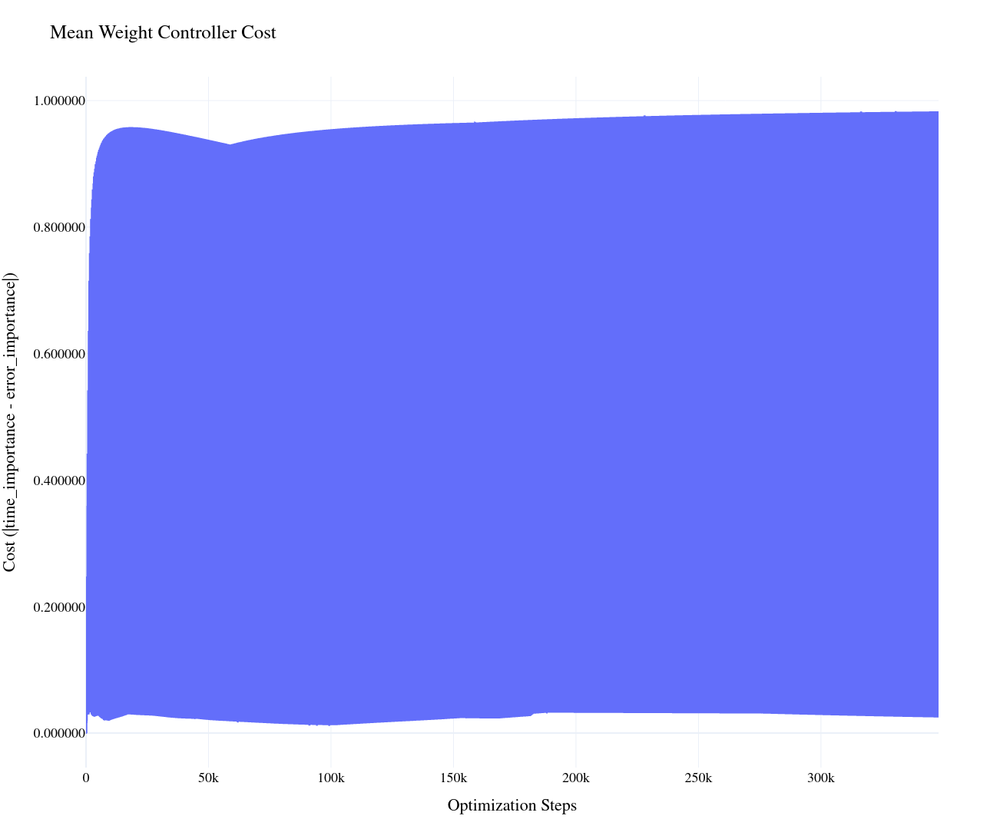

In [130]:
costs = get_costs(mab_weight_mab_voting100)
i=0
visualize(costs)

## Mean Cost Decision Mab

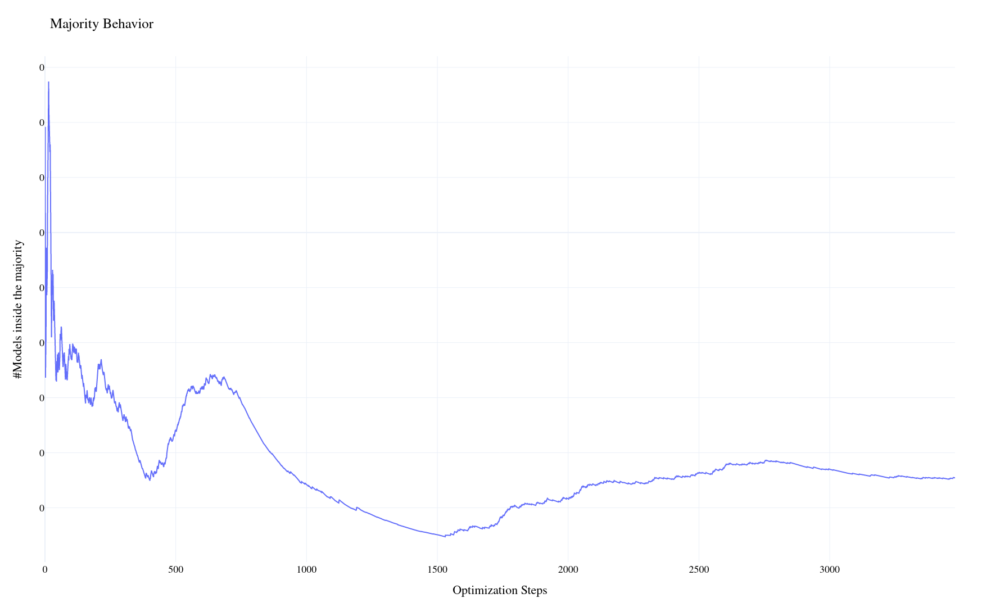

In [161]:
costs = mab_mab_voting100[" Mean Cost"]
i=0
temp = []
costs_grouped = []
for cost in costs:
    temp.append(cost)
    i += 1
    if i == 100:
        costs_grouped.append(np.mean(temp))
        temp=[]
        i = 0
visualize(costs_grouped)


## Majority Size

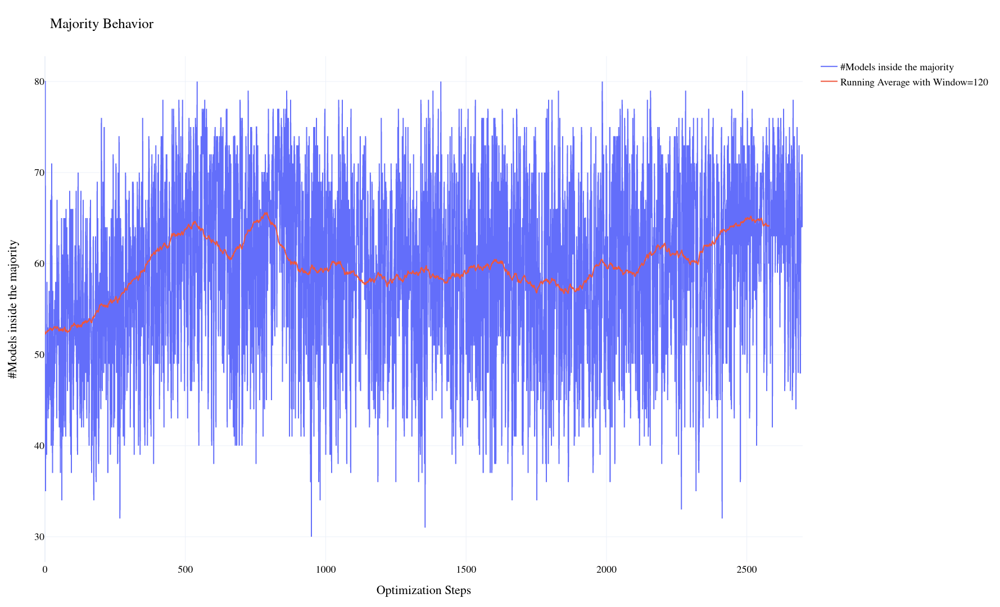

In [158]:
visualize(controller_mab_voting80["Majority_Model_Parameters"],  np.convolve(controller_mab_voting80["Majority_Model_Parameters"].to_numpy(), np.ones(120), "valid")/120)
#controller_mab_voting100["Majority_Model_Parameters"]

## Lollipop

(1, 1)
(1, 2)
(2, 1)
(2, 2)


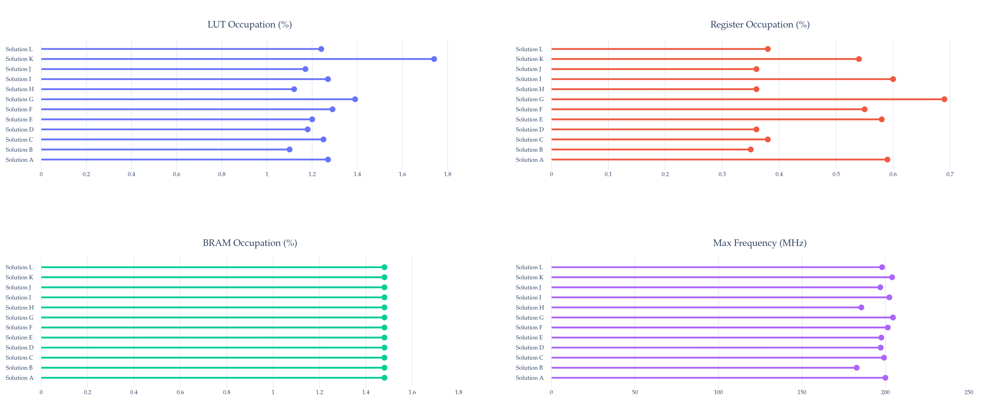

In [221]:
metrics = [
    "LUT Occupation (%)",
    "Register Occupation (%)",
    "BRAM Occupation (%)",
    "Max Frequency (MHz)",
] # metrics in the same order
number_of_design_points = 13 # #points in the pareto set
lollipop(objective_space_voting100, metrics)

## Mean Exact Execution Time

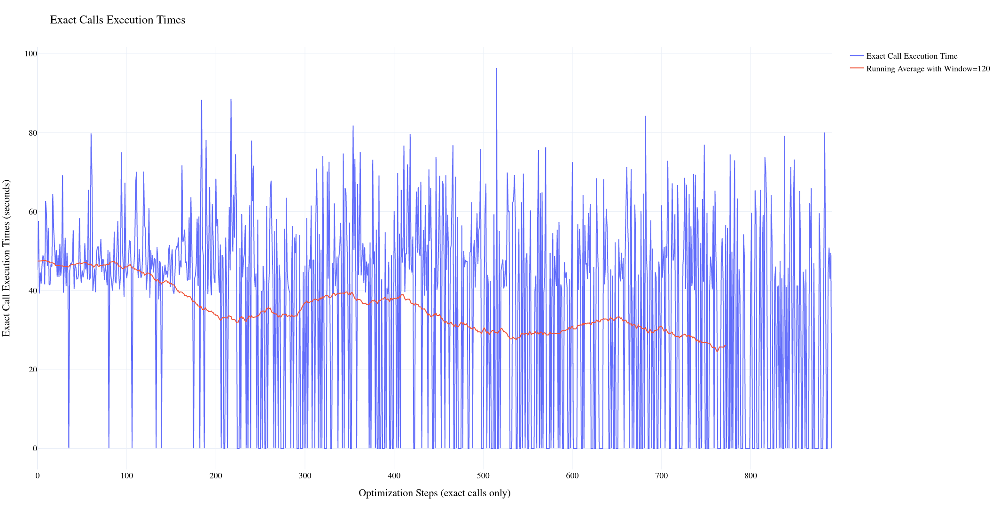

In [234]:
exact_time = controller_mab_voting80[controller_mab_voting80["Estimation"]==0].loc[:, "Exec_Time"]
visualize(exact_time, np.convolve(exact_time, np.ones(120), "valid")/120)

In [39]:
controller_exact[" Estimation"].value_counts()

0    3270
Name:  Estimation, dtype: int64

In [34]:
controller_mab_voting100["Estimation"].value_counts()

1    2435
0    1045
Name: Estimation, dtype: int64

In [41]:
controller_mab_voting80["Estimation"].value_counts()

1    1808
0     892
Name: Estimation, dtype: int64